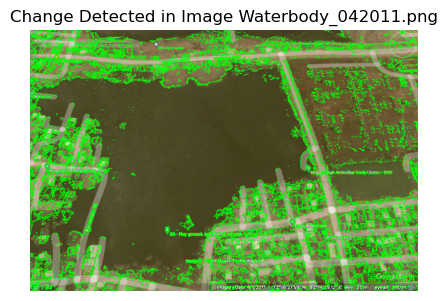

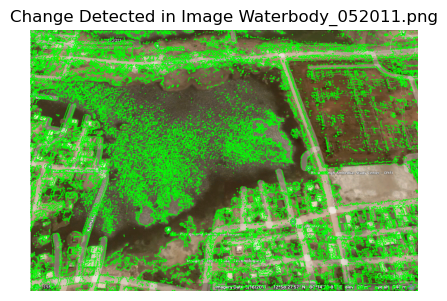

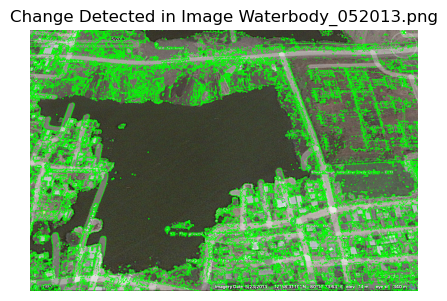

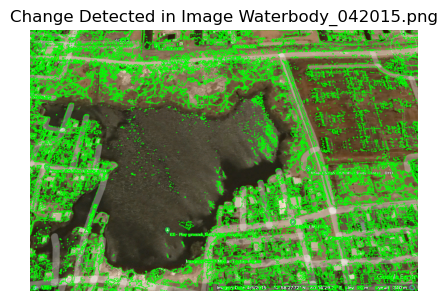

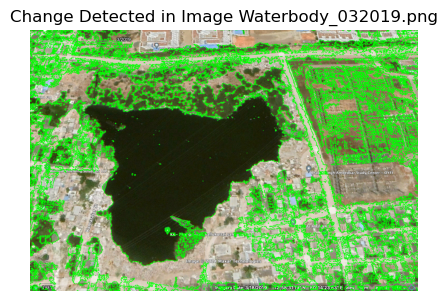

...

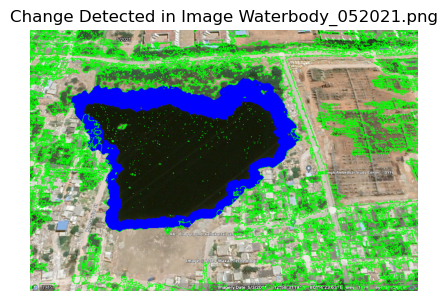

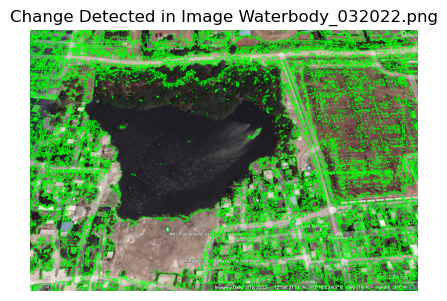

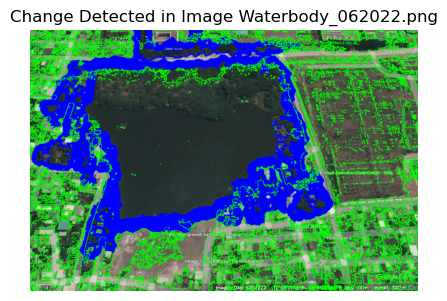

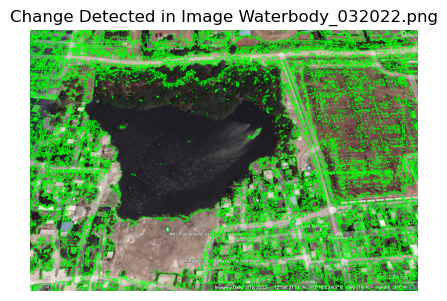

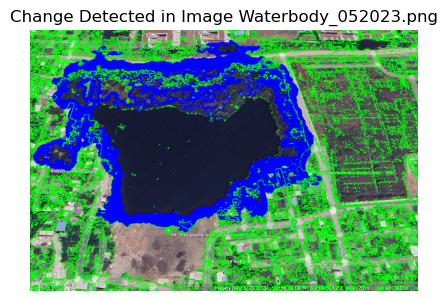

In [1]:
import cv2
import numpy as np
import os
from datetime import datetime
import matplotlib.pyplot as plt

##Load the images - Read all the lake images into an array for processing.
##Preprocess the images - Convert the images to a comparable format, likely grayscale or thresholded binary images to highlight the lake.
##Compute differences - For each image, compute the difference with the reference image to identify changes.
##Analyze changes - Use the differences to quantify the changes in the lake area, color, or other relevant features.

##OpenCV, many operations require that the input images are of the same size and the same number of channels.
##Determine a common size: This could be the size of the smallest image, or a specific size you choose for your analysis.
##Resize all images to the common size: This will make sure all images have the same dimensions before any arithmetic operations are performed on them.

def load_images(image_files, base_directory):
    images = []
    reference_size = None
    for file in image_files:
        path = os.path.join(base_directory, file)
        image = cv2.imread(path, cv2.IMREAD_COLOR)
        if image is not None:
            if reference_size is None:
                reference_size = image.shape[1], image.shape[0]
            resized_image = cv2.resize(image, reference_size, interpolation=cv2.INTER_AREA)
            images.append(resized_image)
        else:
            print(f"Failed to load image: {file}")
    return images, reference_size

def preprocess_images(images):
    processed_images = []
    for image in images:
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        processed_images.append(gray_image)
    return processed_images

def compute_differences(images):
    reference_image = images[0]
    differences = []
    for image in images[1:]:
        difference = cv2.absdiff(reference_image, image)
        differences.append(difference)
    return differences

def analyze_changes(differences):
    change_analysis = []
    for diff in differences:
        ret, thresh = cv2.threshold(diff, 50, 255, cv2.THRESH_BINARY)
        contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        change_analysis.append(contours)
    return change_analysis

image_files = [
        "Waterbody_032013.png",
    "Waterbody_042011.png",
    "Waterbody_052011.png",
    "Waterbody_052013.png",
    "Waterbody_042015.png",
    "Waterbody_032019.png",
    "Waterbody_092020.png",
    "Waterbody_052021.png",
    "Waterbody_032022.png",
    "Waterbody_062022.png",
    "Waterbody_032022.png",
    "Waterbody_052023.png",
    # ... your image files ...
]
base_directory = "/Users/breisdas/Mastermind/Velachery_waterbody/Images/"

images, reference_size = load_images(image_files, base_directory)
if not images:
    print("No images could be loaded, exiting the analysis.")
else:
    processed_images = preprocess_images(images)
    differences = compute_differences(processed_images)
    changes = analyze_changes(differences)

    for idx, change in enumerate(changes):
        plt.figure(figsize=(5,5))
        # Ensure the changes are visualized correctly
        if change:  # Check if there are any contours detected
            for contour in change:
                cv2.drawContours(images[idx+1], contour, -1, (0,255,0), 3)
            plt.imshow(cv2.cvtColor(images[idx+1], cv2.COLOR_BGR2RGB))
            plt.title(f'Change Detected in Image {image_files[idx+1]}')
        else:
            plt.imshow(cv2.cvtColor(images[0], cv2.COLOR_BGR2RGB))  # Show reference image if no change
            plt.title('No Change Detected')
        plt.axis('off')
        plt.show()




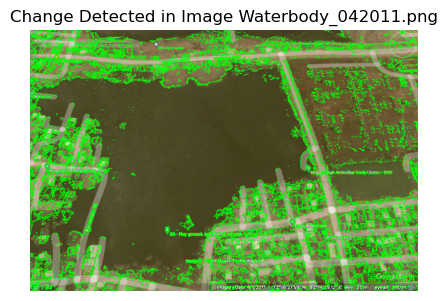

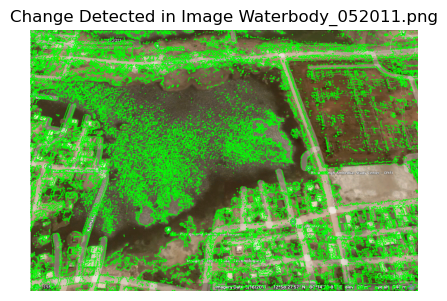

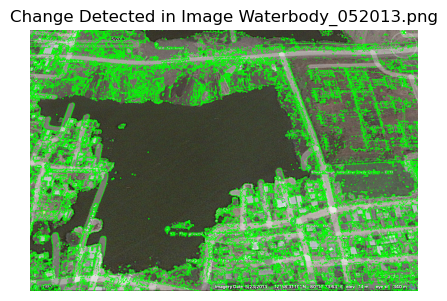

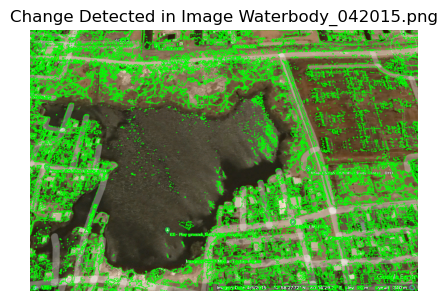

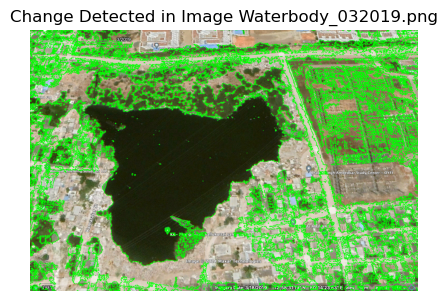

...

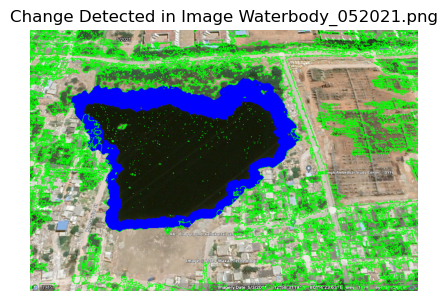

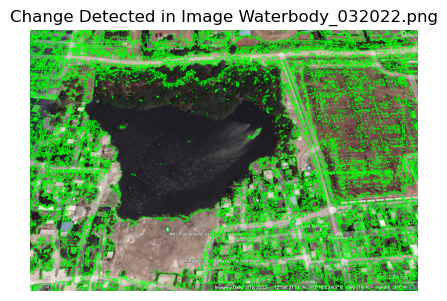

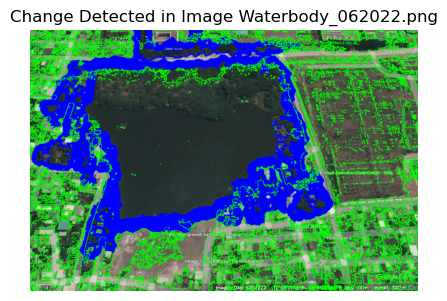

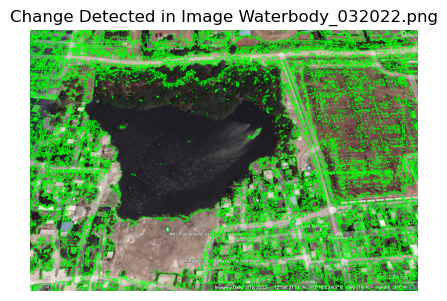

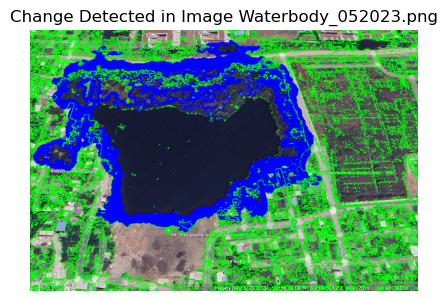


Summary of Detected Changes:
Image Waterbody_042011.png: 8354 regions changed with a total area of 308715.50 pixels
Image Waterbody_052011.png: 12126 regions changed with a total area of 692224.50 pixels
Image Waterbody_052013.png: 10534 regions changed with a total area of 415286.00 pixels
Image Waterbody_042015.png: 9715 regions changed with a total area of 605031.50 pixels
Image Waterbody_032019.png: 5894 regions changed with a total area of 1460742.00 pixels
Image Waterbody_092020.png: 8695 regions changed with a total area of 851962.00 pixels
Image Waterbody_052021.png: 5671 regions changed with a total area of 1588943.50 pixels
Image Waterbody_032022.png: 8478 regions changed with a total area of 1049601.50 pixels
Image Waterbody_062022.png: 6673 regions changed with a total area of 1024157.50 pixels
Image Waterbody_032022.png: 8478 regions changed with a total area of 1049601.50 pixels
Image Waterbody_052023.png: 8562 regions changed with a total area of 1078634.00 pixels


In [2]:
import cv2
import numpy as np
import os
from datetime import datetime
import matplotlib.pyplot as plt

def load_images(image_files, base_directory):
    images = []
    reference_size = None
    for file in image_files:
        path = os.path.join(base_directory, file)
        image = cv2.imread(path, cv2.IMREAD_COLOR)
        if image is not None:
            if reference_size is None:
                reference_size = image.shape[1], image.shape[0]
            resized_image = cv2.resize(image, reference_size, interpolation=cv2.INTER_AREA)
            images.append(resized_image)
        else:
            print(f"Failed to load image: {file}")
    return images, reference_size

def preprocess_images(images):
    processed_images = []
    for image in images:
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        processed_images.append(gray_image)
    return processed_images

def compute_differences(images):
    reference_image = images[0]
    differences = []
    for image in images[1:]:
        difference = cv2.absdiff(reference_image, image)
        differences.append(difference)
    return differences

def analyze_changes(differences):
    change_analysis = []
    change_stats = []
    for diff in differences:
        ret, thresh = cv2.threshold(diff, 50, 255, cv2.THRESH_BINARY)
        contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        total_area = sum(cv2.contourArea(contour) for contour in contours)
        change_analysis.append(contours)
        change_stats.append({'count': len(contours), 'area': total_area})
    return change_analysis, change_stats

# Define your image files and base directory
image_files = [
    "Waterbody_032013.png",
    "Waterbody_042011.png",
    "Waterbody_052011.png",
    "Waterbody_052013.png",
    "Waterbody_042015.png",
    "Waterbody_032019.png",
    "Waterbody_092020.png",
    "Waterbody_052021.png",
    "Waterbody_032022.png",
    "Waterbody_062022.png",
    "Waterbody_032022.png",
    "Waterbody_052023.png",
]
base_directory = "/Users/breisdas/Mastermind/Velachery_waterbody/Images/"

images, reference_size = load_images(image_files, base_directory)
if not images:
    print("No images could be loaded, exiting the analysis.")
else:
    processed_images = preprocess_images(images)
    differences = compute_differences(processed_images)
    changes, stats = analyze_changes(differences)

    summary = []
    for idx, (change, stat) in enumerate(zip(changes, stats)):
        plt.figure(figsize=(5,5))
        if change:  # Check if there are any contours detected
            for contour in change:
                cv2.drawContours(images[idx+1], contour, -1, (0,255,0), 3)
            plt.imshow(cv2.cvtColor(images[idx+1], cv2.COLOR_BGR2RGB))
            plt.title(f'Change Detected in Image {image_files[idx+1]}')
            summary.append(f"Image {image_files[idx+1]}: {stat['count']} regions changed with a total area of {stat['area']:.2f} pixels")
        else:
            plt.imshow(cv2.cvtColor(images[0], cv2.COLOR_BGR2RGB))
            plt.title('No Change Detected')
            summary.append(f"Image {image_files[idx+1]}: No significant change detected.")
        plt.axis('off')
        plt.show()

    # Print summary of changes
    print("\nSummary of Detected Changes:")
    for s in summary:
        print(s)


=========================================================================================================
#Best code 28 Feb 2024 without machine learning integration

#This code utilizes computer vision techniques, specifically with OpenCV, to analyze changes in satellite images of water bodies over time. It does not directly use a machine learning algorithm but instead relies on image processing methods to detect changes. 

#Method Used in the Code

**1- Image Loading and Preprocessing:

        The code loads a series of images from a specified directory.
        It then preprocesses these images by converting them to grayscale or applying other transformations to make them suitable for analysis.

**2- Change Detection:

        The code computes the absolute differences between a reference image (the first image in the series) and subsequent images.
        It applies thresholding to these differences to identify significant changes and then finds contours around these changes.
        The contours represent areas of change between the reference image and each of the other images in the series.

**3- Analysis and Visualization:

        For each image compared with the reference, the code calculates the total area represented by the contours (changes) and counts the number of distinct change regions.
        It visualizes these changes by drawing green contours on the images.
        A graph is plotted to show the total area of change over time, providing a visual summary of how the water body has changed across the images.
        The code also displays the reference image and the image that represents the biggest change in comparison to the reference image.
        
**Requirements about OpenCV

##OpenCV, many operations require that the input images are of the same size and the same number of channels.
##Determine a common size: This could be the size of the smallest image, or a specific size you choose for your analysis.
##Resize all images to the common size: This will make sure all images have the same dimensions before any arithmetic operations are performed on them.


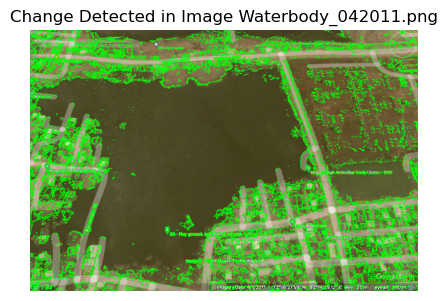

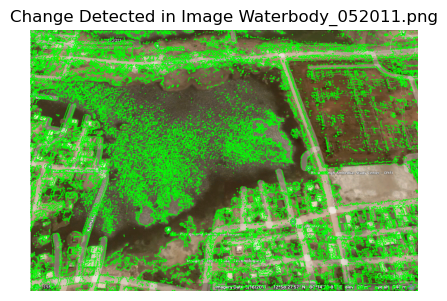

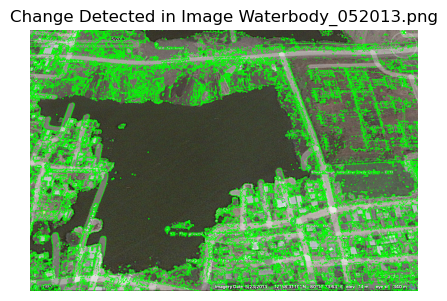

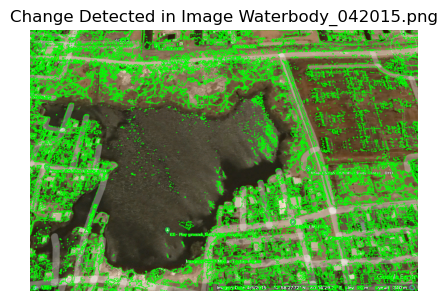

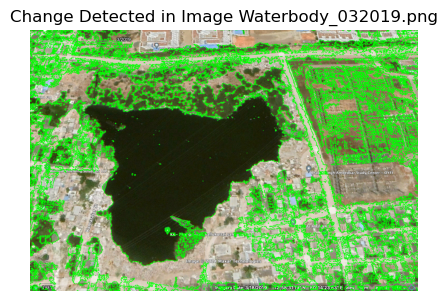

...

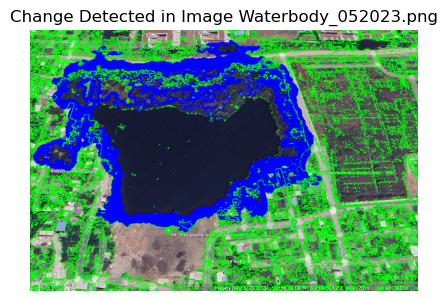

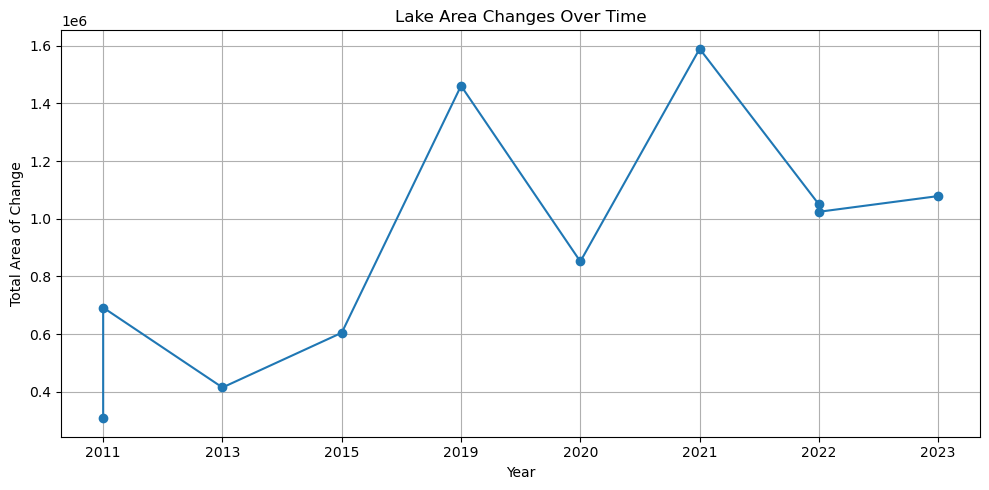

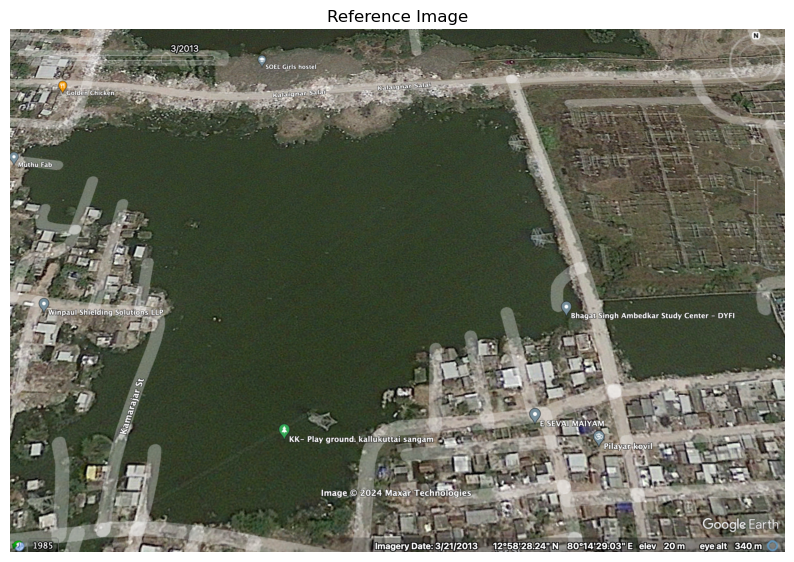

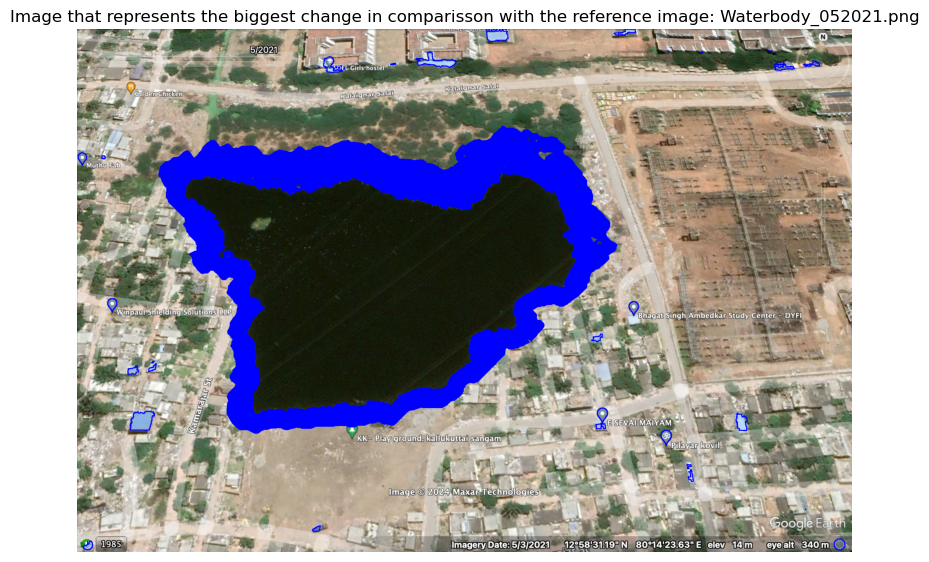

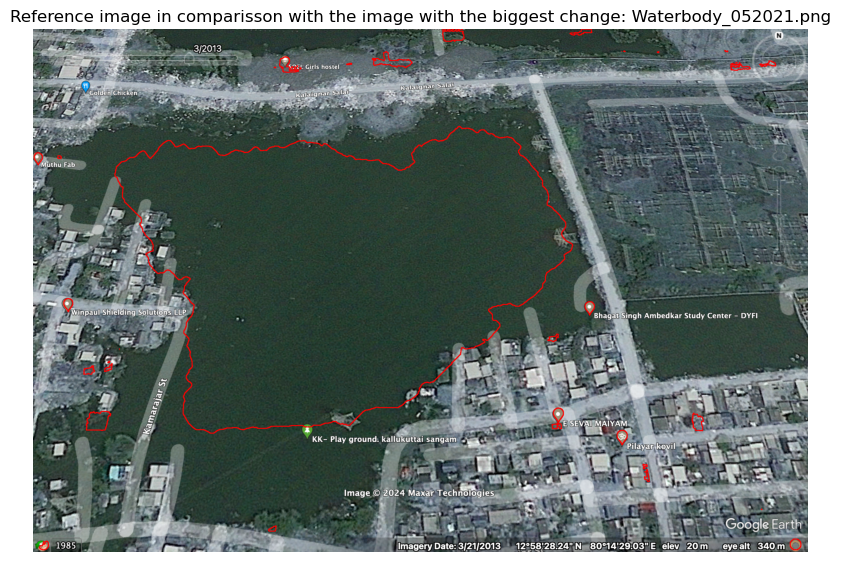


Summary of Detected Changes:
Image Waterbody_042011.png: 8354 regions changed with a total area of 308715.50 pixels
Image Waterbody_052011.png: 12126 regions changed with a total area of 692224.50 pixels
Image Waterbody_052013.png: 10534 regions changed with a total area of 415286.00 pixels
Image Waterbody_042015.png: 9715 regions changed with a total area of 605031.50 pixels
Image Waterbody_032019.png: 5894 regions changed with a total area of 1460742.00 pixels
Image Waterbody_092020.png: 8695 regions changed with a total area of 851962.00 pixels
Image Waterbody_052021.png: 5671 regions changed with a total area of 1588943.50 pixels
Image Waterbody_032022.png: 8478 regions changed with a total area of 1049601.50 pixels
Image Waterbody_062022.png: 6673 regions changed with a total area of 1024157.50 pixels
Image Waterbody_032022.png: 8478 regions changed with a total area of 1049601.50 pixels
Image Waterbody_052023.png: 8562 regions changed with a total area of 1078634.00 pixels


In [3]:
import cv2
import numpy as np
import os
from datetime import datetime
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import re

# Other functions (load_images, preprocess_images, compute_differences) are assumed to be above this code and unchanged

def analyze_changes(differences):
    change_analysis = []
    change_stats = []
    for diff in differences:
        ret, thresh = cv2.threshold(diff, 50, 255, cv2.THRESH_BINARY)
        contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        total_area = sum(cv2.contourArea(contour) for contour in contours)
        change_analysis.append(contours)
        change_stats.append({'count': len(contours), 'area': total_area})
    return change_analysis, change_stats

# Define your image files and base directory
image_files = [
    "Waterbody_032013.png",
    "Waterbody_042011.png",
    "Waterbody_052011.png",
    "Waterbody_052013.png",
    "Waterbody_042015.png",
    "Waterbody_032019.png",
    "Waterbody_092020.png",
    "Waterbody_052021.png",
    "Waterbody_032022.png",
    "Waterbody_062022.png",
    "Waterbody_032022.png",
    "Waterbody_052023.png",
]
base_directory = "/Users/breisdas/Mastermind/Velachery_waterbody/Images/"
reference_image_path = os.path.join(base_directory, image_files[0])
reference_image = cv2.imread(reference_image_path)

def extract_date(filepath):
    filename = os.path.basename(filepath)
    match = re.search(r'Waterbody_(\d{2})(\d{4})\.png', filename)
    if match:
        date_str = match.group(1) + match.group(2)
        return datetime.strptime(date_str, '%m%Y')
    else:
        raise ValueError(f"Filename {filename} does not contain a valid date in MMYYYY format.")
        
def find_waterbody_contours(image):
    # Convert image to HSV color space
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    # Define range for blue colors typically representing water
    lower_blue = np.array([90, 50, 50])
    upper_blue = np.array([150, 255, 255])
    # Create a binary mask where blue colors are white and the rest are black
    mask = cv2.inRange(hsv, lower_blue, upper_blue)
    # Find contours in the mask
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    return contours

def draw_waterbody_contours(image, contours):
    # Draw contours on the image
    cv2.drawContours(image, contours, -1, (255, 0, 0), 2)
    return image


# Load and preprocess the images
images, reference_size = load_images(image_files, base_directory)
if not images:
    print("No images could be loaded, exiting the analysis.")
else:
    processed_images = preprocess_images(images)
    differences = compute_differences(processed_images)
    changes, stats = analyze_changes(differences)

    # Find the image with the biggest change
    max_change_idx = max(range(len(stats)), key=lambda i: stats[i]['area'])
    biggest_change_image = image_files[max_change_idx + 1]

    # Display all images with changes
    for idx, change in enumerate(changes):
        plt.figure(figsize=(5,5))
        if change:
            for contour in change:
                # Green contours represent the detected changes
                cv2.drawContours(images[idx+1], contour, -1, (0,255,0), 3)
            plt.imshow(cv2.cvtColor(images[idx+1], cv2.COLOR_BGR2RGB))
            plt.title(f'Change Detected in Image {image_files[idx+1]}')
        else:
            plt.imshow(cv2.cvtColor(images[0], cv2.COLOR_BGR2RGB))
            plt.title('No Change Detected')
        plt.axis('off')
        plt.show()

    # Plot the graph of changes over the years
    dates = [extract_date(file) for file in image_files[1:]]
    changes_by_date = {date: stat['area'] for date, stat in zip(dates, stats)}
    sorted_dates = sorted(changes_by_date)
    sorted_changes = [changes_by_date[date] for date in sorted_dates]

    plt.figure(figsize=(10, 5))
    plt.plot([date.strftime('%Y') for date in sorted_dates], sorted_changes, marker='o')
    plt.xlabel('Year')
    plt.ylabel('Total Area of Change')
    plt.title('Lake Area Changes Over Time')
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    
    ##Display the reference image
    
if reference_image is not None:
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(reference_image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for correct color display
    plt.title('Reference Image')
    plt.axis('off')  # Hide the axis
    plt.show()
else:
    print("Reference image is not available.")    

    
# Now, when you want to display the reference image with the biggest change
reference_image_with_biggest_change_path = os.path.join(base_directory, biggest_change_image)
reference_image_with_biggest_change = cv2.imread(reference_image_with_biggest_change_path)
if reference_image_with_biggest_change is None:
    print(f"Failed to load the image with the biggest change from file: {reference_image_with_biggest_change_path}")
else:
    reference_image_with_biggest_change_resized = cv2.resize(reference_image_with_biggest_change, (reference_image.shape[1], reference_image.shape[0]), interpolation=cv2.INTER_AREA)
    contours = find_waterbody_contours(reference_image_with_biggest_change_resized)
    reference_image_with_contours = draw_waterbody_contours(reference_image_with_biggest_change_resized.copy(), contours)  # Make a copy to draw on
    plt.figure(figsize=(10,10))
    plt.imshow(cv2.cvtColor(reference_image_with_contours, cv2.COLOR_BGR2RGB))
    plt.title(f'Image that represents the biggest change in comparisson with the reference image: {biggest_change_image}')
    plt.axis('off')
    plt.show()
    

# Display the reference image with the biggest change
    reference_image_with_biggest_change = cv2.imread(os.path.join(base_directory, biggest_change_image))
    reference_image_with_biggest_change = cv2.resize(reference_image_with_biggest_change, reference_size, interpolation=cv2.INTER_AREA)
    reference_contours = find_waterbody_contours(reference_image_with_biggest_change)
    reference_image_with_contours = draw_waterbody_contours(reference_image, reference_contours)
    plt.figure(figsize=(10,10))
    plt.imshow(reference_image_with_contours)
    plt.title(f'Reference image in comparisson with the image with the biggest change: {biggest_change_image}')
    plt.axis('off')
    plt.show()
    
    
    # Print summary of changes
    print("\nSummary of Detected Changes:")
    for file, stat in zip(image_files[1:], stats):
        print(f"Image {file}: {stat['count']} regions changed with a total area of {stat['area']:.2f} pixels")
        
# Assuming images is a list of images loaded earlier and reference_image is the first one in this list
reference_image = images[0]  # This line ensures reference_image is defined





## Adding accuracy

To add an accuracy algorithm to validate the results based on the reference image, it is needed a ground truth dataset that accurately marks the water bodies in each of your images. This dataset is essential for comparing the detected changes (contours) against the true changes to calculate the accuracy.

Given that such ground truth data is typically in the form of binary masks (where the water bodies are marked in white on a black background, or vice versa), the code below shows a way to calculate accuracy using Intersection over Union (IoU), also known as the Jaccard index. IoU is a common metric for evaluating the performance of image segmentation tasks.

**Step 1: Calculate IoU for Each Image

The IoU metric measures the overlap between two boundaries. It's defined as the area of overlap between the predicted segmentation and the ground truth, divided by the area of union between the predicted segmentation and the ground truth.

In [4]:
def calculate_iou(predicted_mask, ground_truth_mask):
    intersection = np.logical_and(predicted_mask, ground_truth_mask)
    union = np.logical_or(predicted_mask, ground_truth_mask)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score


**Step 2: Create Predicted Masks from Contours

Before calculate IoU, it is needed to convert the detected contours into binary masks that match the format of your ground truth masks:

In [5]:
def contours_to_mask(contours, shape):
    mask = np.zeros(shape, dtype=np.uint8)
    cv2.drawContours(mask, contours, -1, color=1, thickness=cv2.FILLED)  # Fill the detected contours
    return mask


**Step 3: Load Ground Truth Masks and Calculate IoU

Assuming we have ground truth masks named similarly to your images but prefixed or suffixed to indicate they are ground truth (e.g., "Waterbody_032013_gt.png"), we can calculate IoU scores as follows:

In [6]:
def load_ground_truth_masks(image_files, base_directory, gt_suffix="_gt", target_shape=None):
    gt_masks = []
    for file in image_files:
        gt_filename = re.sub(r"(\.png)$", f"{gt_suffix}\\1", file)
        gt_path = os.path.join(base_directory, gt_filename)
        gt_mask = cv2.imread(gt_path, 0)  # Load in grayscale

        if gt_mask is not None:
            _, gt_mask_binary = cv2.threshold(gt_mask, 127, 255, cv2.THRESH_BINARY)
            if target_shape is not None:
                # Resize the binary mask to match the target shape if provided
                gt_mask_binary = cv2.resize(gt_mask_binary, (target_shape[1], target_shape[0]), interpolation=cv2.INTER_NEAREST)
            gt_masks.append(gt_mask_binary > 0)  # Convert to boolean mask
        else:
            print(f"Failed to load ground truth mask: {gt_path}")
            if target_shape is not None:
                # Append a mask of zeros with the target shape if provided
                gt_masks.append(np.zeros(target_shape, dtype=bool))
            else:
                # If target_shape is not provided, handle the error or define a default shape
                print("Error: target_shape not provided and ground truth mask could not be loaded.")
    return gt_masks

# Now, when you call the function, include the target_shape argument:
target_shape = reference_image.shape[:2]  # Assuming reference_image is defined
gt_masks = load_ground_truth_masks(image_files[1:], base_directory, "_gt", target_shape)

def contours_to_mask(contours, target_shape):
    # Create a blank mask with the same dimensions as the target shape
    mask = np.zeros(target_shape, dtype=np.uint8)
    # Draw the contours on the mask with fill
    cv2.drawContours(mask, contours, -1, color=1, thickness=cv2.FILLED)
    return mask


# Assuming 'changes' contains the detected contours for each image
iou_scores = []
for idx, contours in enumerate(changes):
    # Ensure the predicted mask is created with the correct target shape
    predicted_mask = contours_to_mask(contours, target_shape=target_shape)
    # Convert boolean mask to match type for IoU calculation
    predicted_mask_bool = predicted_mask > 0
    iou_score = calculate_iou(predicted_mask_bool, gt_masks[idx])
    iou_scores.append(iou_score)


# Display IoU scores
for file, iou_score in zip(image_files[1:], iou_scores):
    print(f"IoU for {file}: {iou_score:.2f}")


IoU for Waterbody_042011.png: 0.15
IoU for Waterbody_052011.png: 0.29
IoU for Waterbody_052013.png: 0.23
IoU for Waterbody_042015.png: 0.20
IoU for Waterbody_032019.png: 0.60
IoU for Waterbody_092020.png: 0.33
IoU for Waterbody_052021.png: 0.64
IoU for Waterbody_032022.png: 0.35
IoU for Waterbody_062022.png: 0.18
IoU for Waterbody_032022.png: 0.35
IoU for Waterbody_052023.png: 0.32


The Intersection over Union (IoU) scores listed are a measure of the accuracy of your method for detecting changes or segmenting water bodies in images, compared to a ground truth (considered the true or actual measurement, observation, or status that you aim to predict or classify through computational methods). The IoU metric calculates the overlap between the predicted segmentation (in our case, the areas identified as water bodies) and the actual segmentation (the ground truth masks) as a ratio of their intersection over their union.


**IoU Scores Close to 0 (e.g., 0.15): 

A low IoU score suggests that the overlap between the predicted and ground truth areas is minimal. This indicates poor performance of the segmentation or change detection for that particular image. An IoU of 0.15 for Waterbody_042011.png suggests that the detected changes or segmented water bodies align poorly with the actual water bodies marked in the ground truth.

**IoU Scores Close to 1 (e.g., 0.60, 0.64): 

A higher IoU score indicates a strong overlap between the predicted segmentation and the ground truth. This signifies better performance. For instance, scores of 0.60 for Waterbody_032019.png and 0.64 for Waterbody_052021.png imply that the detected changes or water bodies in these images closely match the actual areas, according to the ground truth.

**Variable IoU Scores Across Images: 

The variation in IoU scores across different images (ranging from as low as 0.15 to as high as 0.64) can be attributed to several factors, such as:

        Differences in Image Quality: Variations in lighting, resolution, or clarity can affect the algorithm's ability to detect water bodies accurately.
        Changes in Environmental Conditions: Seasonal changes, weather conditions, or human activities might alter the appearance of water bodies, impacting the detection performance.
        Inconsistencies in Ground Truth Data: The accuracy and precision of the ground truth masks themselves can influence the IoU scores. Any errors or approximations in the ground truth will directly affect the perceived accuracy of the predictions.

**Interpretation and Next Steps

    Scores Below 0.5: For images with IoU scores significantly below 0.5, it might be useful to review both the algorithm's output and the ground truth masks to identify potential areas of improvement. Adjusting preprocessing steps, thresholding parameters, or even the contour detection algorithm could enhance performance.

    Scores Above 0.5: For images where IoU scores are closer to or above 0.5, the method seems relatively effective. However, there's still room for improvement, especially if the goal is to achieve high precision and recall in water body detection or change monitoring.

    Overall Performance: An average IoU score across all images can provide a general sense of the algorithm's performance. However, considering the best and worst cases is crucial for identifying specific challenges and opportunities for refinement.

To improve overall performance, consider experimenting with more advanced image segmentation techniques, such as using machine learning models trained specifically for water body detection. These models can potentially provide more robust and accurate segmentation across a wider range of conditions and images.

=================================================================================================================

## Adding Machine Learning to the Code


**Prepare a Dataset: Collect and label a sufficient number of satellite images with water bodies.
**Train a Model: Use a deep learning framework like TensorFlow or PyTorch to train a CNN on our dataset.
**Apply the Model: Replace the manual thresholding and contour detection with our trained model to segment water 
bodies in each image.
**Analyze Changes: Use the output of your model to analyze changes over time as before.
    
    

To integrate a machine learning approach using PyTorch for training a Convolutional Neural Network (CNN) on our dataset, we'll go through the steps required to set up a basic CNN model for image segmentation tasks. This involves preparing your dataset, defining a model, setting up a training loop, and evaluating the model. For simplicity, we'll focus on a scenario where you're training a model to segment water bodies from satellite images.

**Step 1: Environment Setup

Ensure you have PyTorch installed. (pip install torch torchvision)

**Step 2: Prepare the Dataset

Organize the dataset into a structure suitable for training and validation. You'll need images and their corresponding ground truth masks. For this example, let's assume your dataset is ready and split into training and validation sets.

**Step 3: Define a Dataset Class



from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import PIL.Image as Image

class WaterbodyDataset(Dataset):
    def __init__(self, image_paths, mask_paths, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert("RGB")
        mask = Image.open(self.mask_paths[idx]).convert("L")  # Assuming masks are in grayscale
        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)
        return image, mask


**Step 4: Define the CNN Model

We'll use a simple U-Net architecture as an example.Implementing a U-Net from scratch involves defining a neural network architecture that consists of a contracting path (encoder) to capture context and a symmetric expanding path (decoder) that enables precise localization. U-Net is particularly popular for segmentation tasks because of its effectiveness in working with fewer training samples and its ability to produce good segmentation maps.

import torch
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):
    """(convolution => [BN] => ReLU) * 2"""
    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()
        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class Down(nn.Module):
    """Downscaling with maxpool then double conv"""
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

class Up(nn.Module):
    """Upscaling then double conv"""
    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(in_channels , in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]
        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2])
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

class UNet(nn.Module):
    def __init__(self, n_channels, n_classes, bilinear=True):
        super(UNet, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear

        self.inc = DoubleConv(n_channels, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        factor = 2 if bilinear else 1
        self.down4 = Down(512, 1024 // factor)
        self.up1 = Up(1024, 512 // factor, bilinear)
        self.up2 = Up(512, 256 // factor, bilinear)
        self.up3 = Up(256, 128 // factor, bilinear)
        self.up4 = Up(128, 64, bilinear)
        self.outc = OutConv(64, n_classes)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outc(x)
        return logits

    # Initialize the U-Net model
model = UNet(n_channels=3, n_classes=1)  # For binary segmentation, e.g., water body vs. non-water body

# Move the model to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

**Step 5: Training Loop

Set up the training loop. This involves defining your loss function, optimizer, and the actual loop where you train your model over several epochs.

# Define the number of epochs
num_epochs = 25  # Example value; adjust based on your needs

# Assuming you have defined your model as 'model'
criterion = nn.BCELoss()  # Binary Cross-Entropy Loss for binary segmentation tasks
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    for images, masks in train_loader:  # Assuming you have a DataLoader 'train_loader'
        images, masks = images.to(device), masks.to(device)  # Move data to the device (CPU or GPU)
        
        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, masks)
        
        # Backward and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
        
    avg_loss = total_loss / len(train_loader)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {avg_loss:.4f}")


**Step 6: Evaluation

After training, evaluate your model on the validation set to understand its performance.

# Initialize the U-Net model
model = UNet(n_channels=3, n_classes=1)  # For binary segmentation, e.g., water body vs. non-water body

# Move the model to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# Continue with dataset preparation, loss function definition, optimizer setup, and training loop...


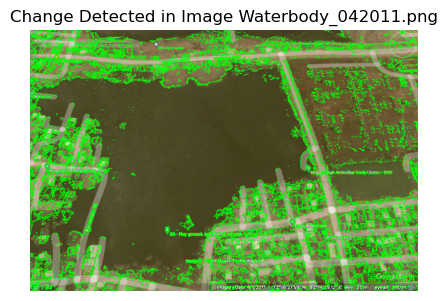

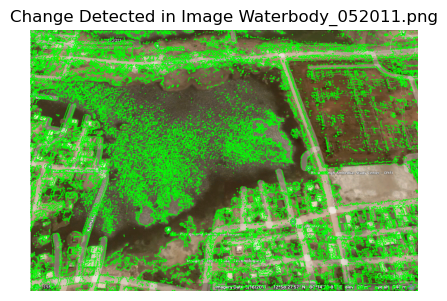

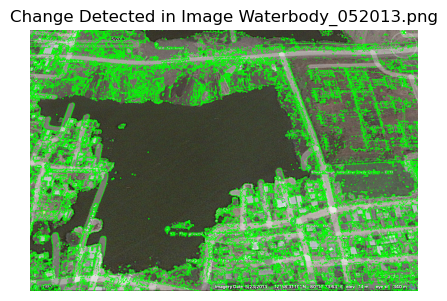

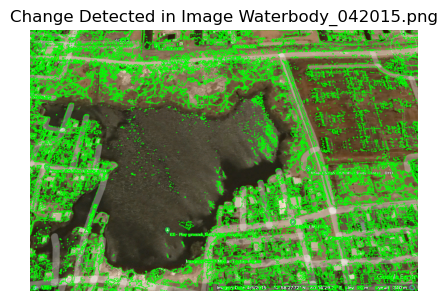

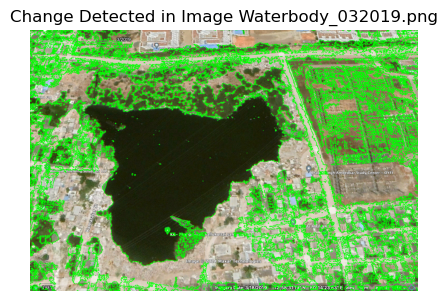

...

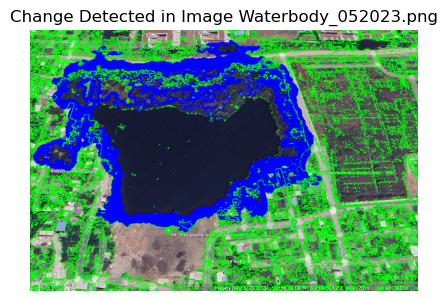

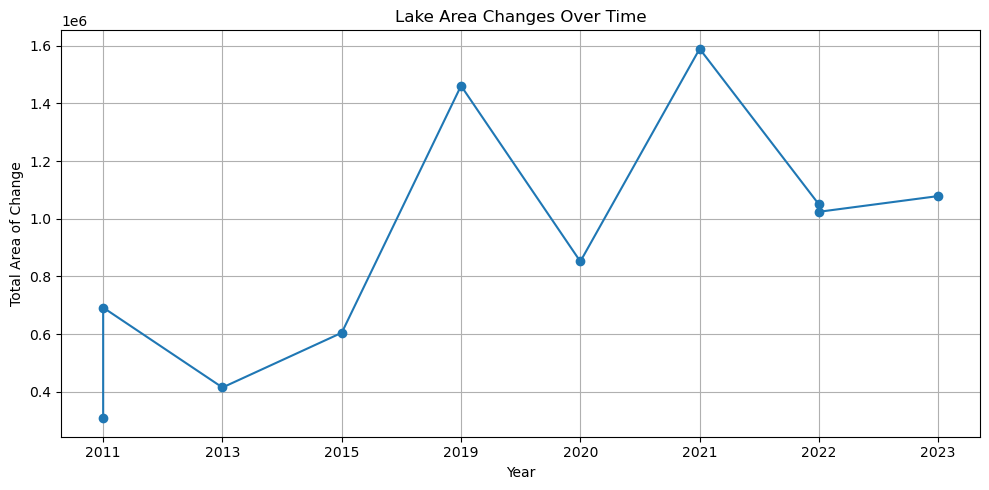

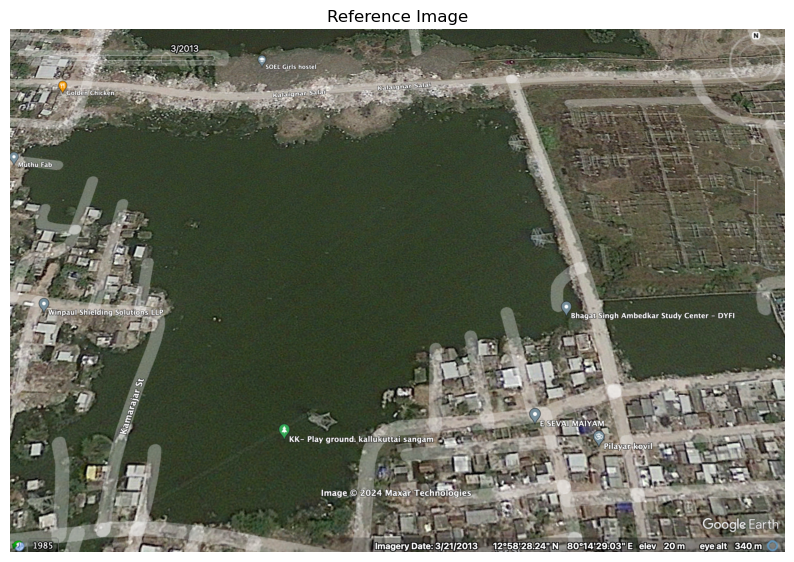

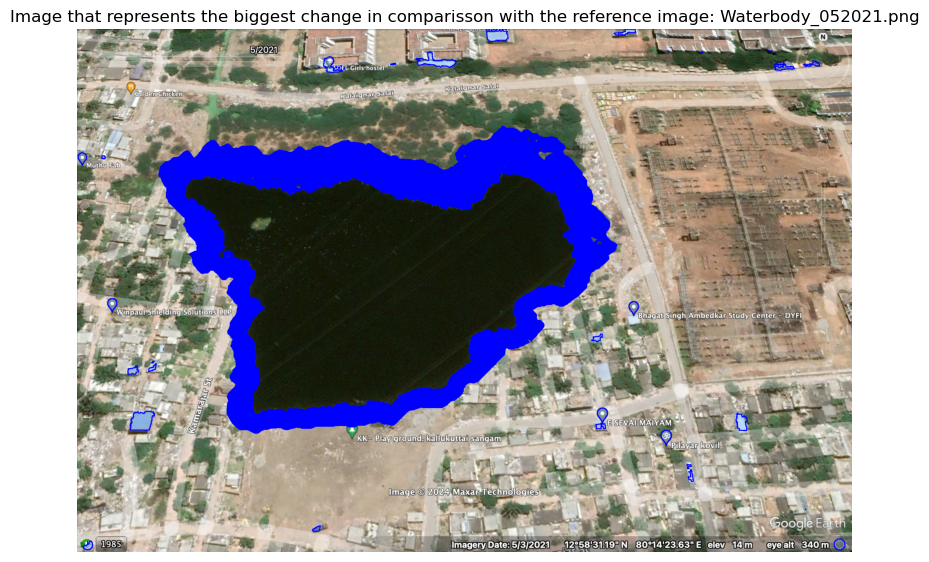

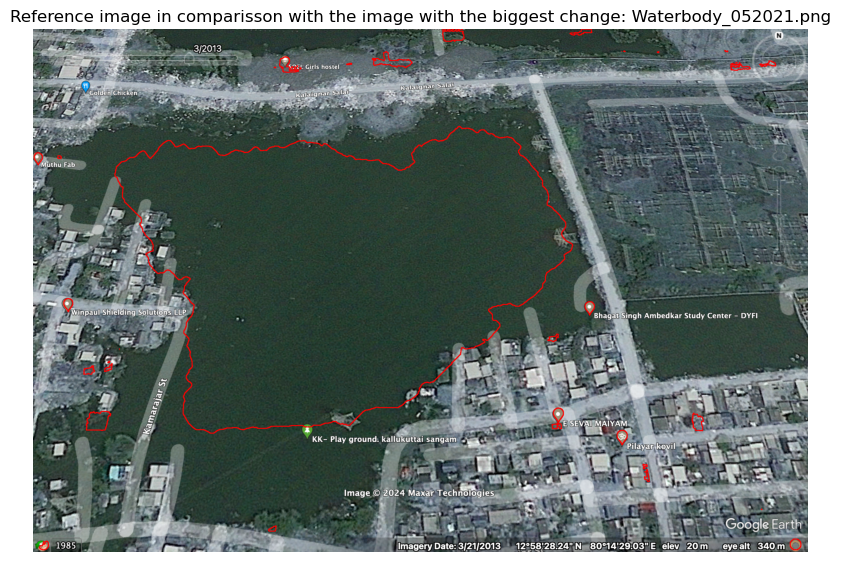


Summary of Detected Changes:
Image Waterbody_042011.png: 8354 regions changed with a total area of 308715.50 pixels
Image Waterbody_052011.png: 12126 regions changed with a total area of 692224.50 pixels
Image Waterbody_052013.png: 10534 regions changed with a total area of 415286.00 pixels
Image Waterbody_042015.png: 9715 regions changed with a total area of 605031.50 pixels
Image Waterbody_032019.png: 5894 regions changed with a total area of 1460742.00 pixels
Image Waterbody_092020.png: 8695 regions changed with a total area of 851962.00 pixels
Image Waterbody_052021.png: 5671 regions changed with a total area of 1588943.50 pixels
Image Waterbody_032022.png: 8478 regions changed with a total area of 1049601.50 pixels
Image Waterbody_062022.png: 6673 regions changed with a total area of 1024157.50 pixels
Image Waterbody_032022.png: 8478 regions changed with a total area of 1049601.50 pixels
Image Waterbody_052023.png: 8562 regions changed with a total area of 1078634.00 pixels


In [7]:
import cv2
import numpy as np
import os
from datetime import datetime
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import re

# Other functions (load_images, preprocess_images, compute_differences) are assumed to be above this code and unchanged

def analyze_changes(differences):
    change_analysis = []
    change_stats = []
    for diff in differences:
        ret, thresh = cv2.threshold(diff, 50, 255, cv2.THRESH_BINARY)
        contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        total_area = sum(cv2.contourArea(contour) for contour in contours)
        change_analysis.append(contours)
        change_stats.append({'count': len(contours), 'area': total_area})
    return change_analysis, change_stats

# Define your image files and base directory
image_files = [
    "Waterbody_032013.png",
    "Waterbody_042011.png",
    "Waterbody_052011.png",
    "Waterbody_052013.png",
    "Waterbody_042015.png",
    "Waterbody_032019.png",
    "Waterbody_092020.png",
    "Waterbody_052021.png",
    "Waterbody_032022.png",
    "Waterbody_062022.png",
    "Waterbody_032022.png",
    "Waterbody_052023.png",
]
base_directory = "/Users/breisdas/Mastermind/Velachery_waterbody/Images/"
reference_image_path = os.path.join(base_directory, image_files[0])
reference_image = cv2.imread(reference_image_path)

def extract_date(filepath):
    filename = os.path.basename(filepath)
    match = re.search(r'Waterbody_(\d{2})(\d{4})\.png', filename)
    if match:
        date_str = match.group(1) + match.group(2)
        return datetime.strptime(date_str, '%m%Y')
    else:
        raise ValueError(f"Filename {filename} does not contain a valid date in MMYYYY format.")
        
def find_waterbody_contours(image):
    # Convert image to HSV color space
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    # Define range for blue colors typically representing water
    lower_blue = np.array([90, 50, 50])
    upper_blue = np.array([150, 255, 255])
    # Create a binary mask where blue colors are white and the rest are black
    mask = cv2.inRange(hsv, lower_blue, upper_blue)
    # Find contours in the mask
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    return contours

def draw_waterbody_contours(image, contours):
    # Draw contours on the image
    cv2.drawContours(image, contours, -1, (255, 0, 0), 2)
    return image


# Load and preprocess the images
images, reference_size = load_images(image_files, base_directory)
if not images:
    print("No images could be loaded, exiting the analysis.")
else:
    processed_images = preprocess_images(images)
    differences = compute_differences(processed_images)
    changes, stats = analyze_changes(differences)

    # Find the image with the biggest change
    max_change_idx = max(range(len(stats)), key=lambda i: stats[i]['area'])
    biggest_change_image = image_files[max_change_idx + 1]

    # Display all images with changes
    for idx, change in enumerate(changes):
        plt.figure(figsize=(5,5))
        if change:
            for contour in change:
                # Green contours represent the detected changes
                cv2.drawContours(images[idx+1], contour, -1, (0,255,0), 3)
            plt.imshow(cv2.cvtColor(images[idx+1], cv2.COLOR_BGR2RGB))
            plt.title(f'Change Detected in Image {image_files[idx+1]}')
        else:
            plt.imshow(cv2.cvtColor(images[0], cv2.COLOR_BGR2RGB))
            plt.title('No Change Detected')
        plt.axis('off')
        plt.show()

    # Plot the graph of changes over the years
    dates = [extract_date(file) for file in image_files[1:]]
    changes_by_date = {date: stat['area'] for date, stat in zip(dates, stats)}
    sorted_dates = sorted(changes_by_date)
    sorted_changes = [changes_by_date[date] for date in sorted_dates]

    plt.figure(figsize=(10, 5))
    plt.plot([date.strftime('%Y') for date in sorted_dates], sorted_changes, marker='o')
    plt.xlabel('Year')
    plt.ylabel('Total Area of Change')
    plt.title('Lake Area Changes Over Time')
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    
    ##Display the reference image
    
if reference_image is not None:
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(reference_image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for correct color display
    plt.title('Reference Image')
    plt.axis('off')  # Hide the axis
    plt.show()
else:
    print("Reference image is not available.")    

    
# Now, when you want to display the reference image with the biggest change
reference_image_with_biggest_change_path = os.path.join(base_directory, biggest_change_image)
reference_image_with_biggest_change = cv2.imread(reference_image_with_biggest_change_path)
if reference_image_with_biggest_change is None:
    print(f"Failed to load the image with the biggest change from file: {reference_image_with_biggest_change_path}")
else:
    reference_image_with_biggest_change_resized = cv2.resize(reference_image_with_biggest_change, (reference_image.shape[1], reference_image.shape[0]), interpolation=cv2.INTER_AREA)
    contours = find_waterbody_contours(reference_image_with_biggest_change_resized)
    reference_image_with_contours = draw_waterbody_contours(reference_image_with_biggest_change_resized.copy(), contours)  # Make a copy to draw on
    plt.figure(figsize=(10,10))
    plt.imshow(cv2.cvtColor(reference_image_with_contours, cv2.COLOR_BGR2RGB))
    plt.title(f'Image that represents the biggest change in comparisson with the reference image: {biggest_change_image}')
    plt.axis('off')
    plt.show()
    

# Display the reference image with the biggest change
    reference_image_with_biggest_change = cv2.imread(os.path.join(base_directory, biggest_change_image))
    reference_image_with_biggest_change = cv2.resize(reference_image_with_biggest_change, reference_size, interpolation=cv2.INTER_AREA)
    reference_contours = find_waterbody_contours(reference_image_with_biggest_change)
    reference_image_with_contours = draw_waterbody_contours(reference_image, reference_contours)
    plt.figure(figsize=(10,10))
    plt.imshow(reference_image_with_contours)
    plt.title(f'Reference image in comparisson with the image with the biggest change: {biggest_change_image}')
    plt.axis('off')
    plt.show()
    
    
    # Print summary of changes
    print("\nSummary of Detected Changes:")
    for file, stat in zip(image_files[1:], stats):
        print(f"Image {file}: {stat['count']} regions changed with a total area of {stat['area']:.2f} pixels")
        
# Assuming images is a list of images loaded earlier and reference_image is the first one in this list
reference_image = images[0]  # This line ensures reference_image is defined





In [8]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):
    """(convolution => [BN] => ReLU) * 2"""
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class Down(nn.Module):
    """Downscaling with maxpool then double conv"""
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()
        # Adjust for the expected number of channels after concatenation
        if bilinear:
            # Assuming 'in_channels' is the total number of channels after concatenation
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            # Correctly calculate the input channels for DoubleConv
            # 'in_channels' should include the concatenated channels from 'x2'
            correct_in_channels = in_channels // 2 + in_channels // 2  # Adjust this calculation as needed
            self.conv = DoubleConv(correct_in_channels, out_channels)
        else:
            self.up = nn.ConvTranspose2d(in_channels // 2, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)  # Adjust 'in_channels' as needed for your architecture

    def forward(self, x1, x2):
        x1 = self.up(x1)
        # Concatenate 'x1' and 'x2' along the channel dimension
        x = torch.cat([x2, x1], dim=1)  # Ensure the total channels match 'correct_in_channels'
        return self.conv(x)



class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

class UNet(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(UNet, self).__init__()
        self.inc = DoubleConv(n_channels, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        self.down4 = Down(512, 512)
        self.up1 = Up(1024, 256)
        self.up2 = Up(512, 128)
        self.up3 = Up(256, 64)
        self.up4 = Up(128, 64)
        self.outc = OutConv(64, n_classes)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outc(x)
        return logits


**Integrating U-Net into the Workflow

After defining the U-Net model as above, you can proceed to integrate it into your image processing and machine learning workflow:

1- Prepare your dataset for training and validation, ensuring you have corresponding ground truth masks for each satellite image.

2- Instantiate the U-Net model with the number of input channels corresponding to your images (e.g., 3 for RGB images) and the number of output channels (e.g., 1 for binary segmentation tasks like water body detection).

3- Train the model using the prepared dataset, employing the training loop as outlined in the previous instructions.

In [9]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import PIL.Image as Image
import cv2
import numpy as np
import os
from datetime import datetime
import matplotlib.pyplot as plt
import re

##Step 1: Prepare the Dataset

class WaterbodyDataset(Dataset):
    def __init__(self, image_paths, mask_paths, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert("RGB")
        mask = Image.open(self.mask_paths[idx]).convert("L")
        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)
        return image, mask

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((256, 256)),
])

# Replace these paths with your actual dataset directories
image_dir = "/Users/breisdas/Mastermind/Velachery_waterbody/Images/"
mask_dir = "/Users/breisdas/Mastermind/Velachery_waterbody/Images/"
image_files = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.png')]
mask_files = [os.path.join(mask_dir, f) for f in os.listdir(mask_dir) if f.endswith('.png')]

dataset = WaterbodyDataset(image_paths=image_files, mask_paths=mask_files, transform=transform)
train_loader = DataLoader(dataset, batch_size=4, shuffle=True)



/Users/breisdas/anaconda3/lib/python3.11/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: 'dlopen(/Users/breisdas/anaconda3/lib/python3.11/site-packages/torchvision/image.so, 0x0006): Symbol not found: __ZN3c1017RegisterOperatorsD1Ev
  Referenced from: <CFED5F8E-EC3F-36FD-AAA3-2C6C7F8D3DD9> /Users/breisdas/anaconda3/lib/python3.11/site-packages/torchvision/image.so
  Expected in:     <E459C462-F863-3A5A-AC9F-FD77B14BE845> /Users/breisdas/anaconda3/lib/python3.11/site-packages/torch/lib/libtorch_cpu.dylib'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


In [10]:
#Step 2: Instantiate the U-Net Model

model = UNet(n_channels=3, n_classes=1).to(torch.device("cuda" if torch.cuda.is_available() else "cpu"))


In [11]:
#Step 3: Train the Model

criterion = nn.BCEWithLogitsLoss()  # Suitable for binary classification tasks
optimizer = optim.Adam(model.parameters(), lr=1e-4)
num_epochs = 25

for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    for images, masks in train_loader:
        images, masks = images.to(torch.device("cuda" if torch.cuda.is_available() else "cpu")), masks.to(torch.device("cuda" if torch.cuda.is_available() else "cpu"))
        
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
    
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {total_loss / len(train_loader):.4f}")


/Users/breisdas/anaconda3/lib/python3.11/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


Epoch [1/25], Loss: 0.6384
Epoch [2/25], Loss: 0.6021
Epoch [3/25], Loss: 0.5945
Epoch [4/25], Loss: 0.5945
Epoch [5/25], Loss: 0.5936
Epoch [6/25], Loss: 0.5913
Epoch [7/25], Loss: 0.5870
Epoch [8/25], Loss: 0.5838
Epoch [9/25], Loss: 0.5860
Epoch [10/25], Loss: 0.5877
Epoch [11/25], Loss: 0.5854
Epoch [12/25], Loss: 0.5848
Epoch [13/25], Loss: 0.5857
Epoch [14/25], Loss: 0.5844
Epoch [15/25], Loss: 0.5871
Epoch [16/25], Loss: 0.5826
Epoch [17/25], Loss: 0.5869
Epoch [18/25], Loss: 0.5818
Epoch [19/25], Loss: 0.5844
Epoch [20/25], Loss: 0.5834
Epoch [21/25], Loss: 0.5827
Epoch [22/25], Loss: 0.5815
Epoch [23/25], Loss: 0.5813
Epoch [24/25], Loss: 0.5795
Epoch [25/25], Loss: 0.5827


Convolutional Neural Networks (CNNs) have become a pivotal tool in image recognition tasks, including detecting modifications in landscapes or environmental features such as lakes. While pixel-based analysis can also be used for such tasks, CNNs offer several significant advantages that often make them more effective and versatile. Here are some reasons why CNNs excel in image recognition tasks, especially when compared to pixel-only analysis:
1. Feature Learning:

    Pixel-based Analysis: It typically relies on manual feature selection and is limited to analyzing individual pixels or predefined pixel patterns. This approach might miss complex or subtle features that are crucial for recognizing specific objects or changes in images.
    CNNs: They automatically learn hierarchical feature representations from the data. Early layers may detect edges or colors, while deeper layers can identify more complex patterns or objects. This capability allows CNNs to capture intricate details necessary for accurately identifying and classifying various elements in an image, including subtle modifications.

2. Contextual Understanding:

    Pixel-based Analysis: It often struggles with context since it looks at pixels in isolation or within a very localized neighborhood. This can lead to misinterpretations, especially in complex scenes where the context is critical for accurate identification.
    CNNs: Through their hierarchical structure, CNNs consider both local and global contexts, learning how features relate to each other within an entire scene. This holistic view enables more accurate recognition and understanding of images, including detecting changes over time or differences in environmental features.

3. Robustness to Variations:

    Pixel-based Analysis: Changes in lighting, angles, or occlusions can significantly affect the performance of pixel-based methods, requiring extensive preprocessing or tailored approaches for different conditions.
    CNNs: They are inherently more robust to variations in images due to their ability to learn invariant features. CNNs can recognize objects or patterns regardless of changes in scale, orientation, or lighting, making them highly effective in diverse and challenging conditions.

4. Efficiency at Scale:

    Pixel-based Analysis: Analyzing large datasets or high-resolution images pixel by pixel can be computationally intensive and time-consuming, especially if the analysis requires iterating over multiple scales or orientations.
    CNNs: Once trained, CNNs can quickly process new images, making predictions in a fraction of the time it might take for pixel-based analysis. This efficiency is crucial when dealing with large-scale environmental monitoring tasks, where timely analysis is often necessary.

5. Generalization and Transfer Learning:

    Pixel-based Analysis: It is often tailored to specific tasks or types of images and may not generalize well across different datasets or conditions without significant adjustments.
    CNNs: They have the ability to generalize across different tasks, especially when using techniques like transfer learning. A CNN trained on one set of images can be adapted to a new, but related task with minimal additional training, leveraging the features it has already learned.

In [12]:
self.up1 = Up(1024, 512, bilinear=True)  # Example instantiation with bilinear upsampling


NameError: name 'self' is not defined